## Step 1: Importing Necessary Libraries

In [81]:
#import necessary libraries
import plotly.graph_objs as go
import plotly.io as pio
import plotly.express as px
import pandas as pd
import matplotlib.pyplot as plt
import plotly.offline as py
py.init_notebook_mode(connected=True)


## Step 2: Importing the Datasets

In [82]:
dataset1 = pd.read_csv("covid.csv")
dataset1.head()

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,iso_alpha
0,USA,North America,3.311981e+08,5032179,NaN,162804.0,NaN,2576668.0,NaN,2292707.0,18296.0,15194.0,492.0,63139605.0,190640.0,Americas,USA
1,Brazil,South America,2.127107e+08,2917562,NaN,98644.0,NaN,2047660.0,NaN,771258.0,8318.0,13716.0,464.0,13206188.0,62085.0,Americas,BRA
2,India,Asia,1.381345e+09,2025409,NaN,41638.0,NaN,1377384.0,NaN,606387.0,8944.0,1466.0,30.0,22149351.0,16035.0,South-EastAsia,IND
3,Russia,Europe,1.459409e+08,871894,NaN,14606.0,NaN,676357.0,NaN,180931.0,2300.0,5974.0,100.0,29716907.0,203623.0,Europe,RUS
4,South Africa,Africa,5.938157e+07,538184,NaN,9604.0,NaN,387316.0,NaN,141264.0,539.0,9063.0,162.0,3149807.0,53044.0,Africa,ZAF


In [83]:
print(dataset1.shape)
print(dataset1.size)

(209, 17)
3553


In [84]:
dataset1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209 entries, 0 to 208
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Country/Region    209 non-null    object 
 1   Continent         208 non-null    object 
 2   Population        208 non-null    float64
 3   TotalCases        209 non-null    int64  
 4   NewCases          4 non-null      float64
 5   TotalDeaths       188 non-null    float64
 6   NewDeaths         3 non-null      float64
 7   TotalRecovered    205 non-null    float64
 8   NewRecovered      3 non-null      float64
 9   ActiveCases       205 non-null    float64
 10  Serious,Critical  122 non-null    float64
 11  Tot Cases/1M pop  208 non-null    float64
 12  Deaths/1M pop     187 non-null    float64
 13  TotalTests        191 non-null    float64
 14  Tests/1M pop      191 non-null    float64
 15  WHO Region        184 non-null    object 
 16  iso_alpha         209 non-null    object 
dt

In [85]:
#importing dataset2
dataset2 = pd.read_csv("covid_grouped.csv")
dataset2.head()

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region,iso_alpha
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0,Eastern Mediterranean,AFG
1,2020-01-22,Albania,0,0,0,0,0,0,0,Europe,ALB
2,2020-01-22,Algeria,0,0,0,0,0,0,0,Africa,DZA
3,2020-01-22,Andorra,0,0,0,0,0,0,0,Europe,AND
4,2020-01-22,Angola,0,0,0,0,0,0,0,Africa,AGO


In [86]:
print(dataset2.shape)
print(dataset2.size)

(35156, 11)
386716


In [87]:
dataset2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35156 entries, 0 to 35155
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Date            35156 non-null  object
 1   Country/Region  35156 non-null  object
 2   Confirmed       35156 non-null  int64 
 3   Deaths          35156 non-null  int64 
 4   Recovered       35156 non-null  int64 
 5   Active          35156 non-null  int64 
 6   New cases       35156 non-null  int64 
 7   New deaths      35156 non-null  int64 
 8   New recovered   35156 non-null  int64 
 9   WHO Region      35156 non-null  object
 10  iso_alpha       35156 non-null  object
dtypes: int64(7), object(4)
memory usage: 3.0+ MB


## Step 3: Dataset cleaning

In [88]:
# Columns labels of a Dataset1
dataset1.columns

Index(['Country/Region', 'Continent', 'Population', 'TotalCases', 'NewCases',
       'TotalDeaths', 'NewDeaths', 'TotalRecovered', 'NewRecovered',
       'ActiveCases', 'Serious,Critical', 'Tot Cases/1M pop', 'Deaths/1M pop',
       'TotalTests', 'Tests/1M pop', 'WHO Region', 'iso_alpha'],
      dtype='object')

In [89]:
dataset1.drop(['NewCases', 'NewDeaths', 'NewRecovered'], axis=1, inplace=True)
dataset1.head()

,Country/Region,Continent,Population,TotalCases,TotalDeaths,TotalRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,iso_alpha
0,USA,North America,3.311981e+08,5032179,162804.0,2576668.0,2292707.0,18296.0,15194.0,492.0,63139605.0,190640.0,Americas,USA
1,Brazil,South America,2.127107e+08,2917562,98644.0,2047660.0,771258.0,8318.0,13716.0,464.0,13206188.0,62085.0,Americas,BRA
2,India,Asia,1.381345e+09,2025409,41638.0,1377384.0,606387.0,8944.0,1466.0,30.0,22149351.0,16035.0,South-EastAsia,IND
3,Russia,Europe,1.459409e+08,871894,14606.0,676357.0,180931.0,2300.0,5974.0,100.0,29716907.0,203623.0,Europe,RUS
4,South Africa,Africa,5.938157e+07,538184,9604.0,387316.0,141264.0,539.0,9063.0,162.0,3149807.0,53044.0,Africa,ZAF


In [90]:
dataset1.sample(4)

,Country/Region,Continent,Population,TotalCases,TotalDeaths,TotalRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,iso_alpha
42,Guatemala,North America,17946899.0,54339,2119.0,42070.0,10150.0,5.0,3028.0,118.0,172712.0,9624.0,Americas,GTM
105,Zimbabwe,Africa,14883803.0,4339,84.0,1264.0,2991.0,NaN,292.0,6.0,140421.0,9434.0,Africa,ZWE
129,Iceland,Europe,341465.0,1930,10.0,1825.0,95.0,NaN,5652.0,29.0,149693.0,438385.0,Europe,ISL
208,Western Sahara,Africa,598682.0,10,1.0,8.0,1.0,NaN,17.0,2.0,NaN,NaN,Africa,ESH


In [91]:
#Creating table using plotly express
from plotly.figure_factory import create_table

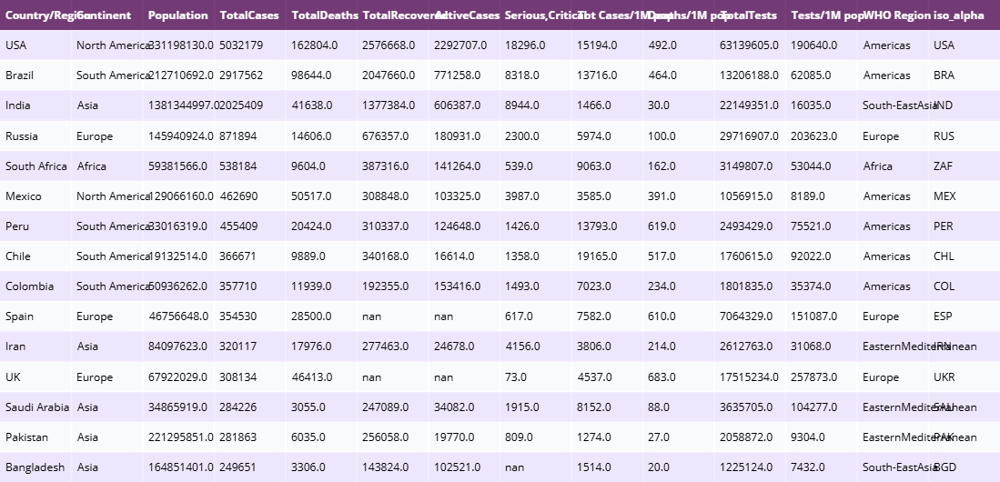

In [131]:
colorscale = [[0, '#4d004c'], [0.5, '#f2e5ff'], [1, '#ffffff']]
table = create_table(dataset1.head(15), colorscale=colorscale)
py.iplot(table)

## Step 4: Bar graphs- Comparisons between COVID infected countries in terms of total cases, total deaths, total recovered & total tests

In [93]:
#Bar graphs- Comparisons between COVID infected countries in terms of total cases, total deaths, total recovered & total tests
px.bar(dataset1.head(15), x='Country/Region', y='TotalCases', color='TotalCases', height=500, hover_data=['Country/Region', 'Continent'])

In [94]:
px.bar(dataset1.head(15), x='Country/Region', y='TotalCases', color='TotalDeaths', height=500, hover_data=['Country/Region', 'Continent'])

In [95]:
px.bar(dataset1.head(15), x='Country/Region', y='TotalCases', color='TotalRecovered', height=500, hover_data=['Country/Region', 'Continent'])

In [96]:
px.bar(dataset1.head(15), x='Country/Region', y='TotalCases',orientation='v', color='TotalTests', height=500, hover_data=['Country/Region', 'Continent'])

In [97]:
px.bar(dataset1.head(15), x='TotalTests', y='Country/Region', color='TotalTests', orientation='h', height=500, hover_data=['Country/Region', 'Continent'])

In [98]:
px.bar(dataset1.head(15), x='TotalTests', y='Continent', color='TotalTests', orientation='h', height=500, hover_data=['Country/Region', 'Continent'])

## Step 5: Data Visualization through Bubble Charts-Continent Wise

In [99]:
px.scatter(dataset1, x='Continent', y='TotalCases', hover_data=['Country/Region', 'Continent'], color='TotalCases', size='TotalCases', size_max=80)

In [100]:
px.scatter(dataset1.head(57), x='Continent', y='TotalCases', hover_data=['Country/Region', 'Continent'], color='TotalCases', size='TotalCases', size_max=80, log_y=True)

In [101]:
px.scatter(dataset1.head(54), x='Continent', y='TotalCases', hover_data=['Country/Region', 'Continent'], color='TotalCases', size='TotalCases', size_max=80)

In [102]:
px.scatter(dataset1.head(50), x='Continent', y='TotalCases', hover_data=['Country/Region', 'Continent'], color='TotalCases', size='TotalCases', size_max=80, log_y=True)

## Step 6: Data Visualization through Bubble Charts-Country Wise

In [103]:
px.scatter(dataset1.head(100), x='Country/Region', y='TotalCases', hover_data=['Country/Region', 'Continent'], color='TotalCases', size='TotalCases', size_max=80)

In [104]:
px.scatter(dataset1.head(30), x='Country/Region', y='TotalCases', hover_data=['Country/Region', 'Continent'], color='Country/Region', size='TotalCases', size_max=80, log_y=True)

In [105]:
px.scatter(dataset1.head(10), x='Country/Region', y='TotalDeaths', hover_data=['Country/Region', 'Continent'], color='Country/Region', size='TotalDeaths', size_max=80)

In [106]:
px.scatter(dataset1.head(30), x='Country/Region', y='Tests/1M pop', hover_data=['Country/Region', 'Continent'], color='Country/Region', size='Tests/1M pop', size_max=80)

In [107]:
px.scatter(dataset1.head(30), x='Country/Region', y='Tests/1M pop', hover_data=['Country/Region', 'Continent'], color='Tests/1M pop', size='Tests/1M pop', size_max=80)

In [108]:
px.scatter(dataset1.head(30), x='TotalCases', y='TotalDeaths', hover_data=['Country/Region', 'Continent'], color='TotalDeaths', size='TotalDeaths', size_max=80)

In [109]:
px.scatter(dataset1.head(30), x='TotalCases', y='TotalDeaths', hover_data=['Country/Region', 'Continent'], color='TotalDeaths', size='TotalDeaths', size_max=80, log_x=True, log_y=True)

In [110]:
px.scatter(dataset1.head(30), x='TotalTests', y='TotalCases', hover_data=['Country/Region', 'Continent'], color='TotalTests', size='TotalTests', size_max=80, log_x=True, log_y=True)

## Step 7: Advanced Data Visualization- Bar graphs for All top infected Countries

In [111]:
dataset2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35156 entries, 0 to 35155
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Date            35156 non-null  object
 1   Country/Region  35156 non-null  object
 2   Confirmed       35156 non-null  int64 
 3   Deaths          35156 non-null  int64 
 4   Recovered       35156 non-null  int64 
 5   Active          35156 non-null  int64 
 6   New cases       35156 non-null  int64 
 7   New deaths      35156 non-null  int64 
 8   New recovered   35156 non-null  int64 
 9   WHO Region      35156 non-null  object
 10  iso_alpha       35156 non-null  object
dtypes: int64(7), object(4)
memory usage: 3.0+ MB


In [112]:
px.bar(dataset2, x='Date', y='Confirmed', color='Confirmed', hover_data=['Confirmed', 'Date', 'Country/Region'], height=400)

In [113]:
px.bar(dataset2, x='Date', y='Confirmed', color='Confirmed', hover_data=['Confirmed', 'Date', 'Country/Region'], height=400, log_y=True)

In [114]:
px.bar(dataset2, x='Date', y='Deaths', color='Deaths', hover_data=["Confirmed", "Date", "Country/Region"], height=400, log_y=False)

## Step 8: Countries Specific COVID Data Visualization: (United States)

In [115]:
df_US = dataset2[dataset2['Country/Region'] == 'US']

In [116]:
df_US.head(5)

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region,iso_alpha
173,2020-01-22,US,1,0,0,1,0,0,0,Americas,USA
360,2020-01-23,US,1,0,0,1,0,0,0,Americas,USA
547,2020-01-24,US,2,0,0,2,1,0,0,Americas,USA
734,2020-01-25,US,2,0,0,2,0,0,0,Americas,USA
921,2020-01-26,US,5,0,0,5,3,0,0,Americas,USA


In [117]:
df_US.shape

(188, 11)

In [118]:
# Now let us plot and study the covid situation in the USA.
px.bar(df_US, x='Date', y='Confirmed', color='Confirmed', height=400)

In [119]:
px.bar(df_US, x='Date', y='Recovered', color='Recovered', height=400)

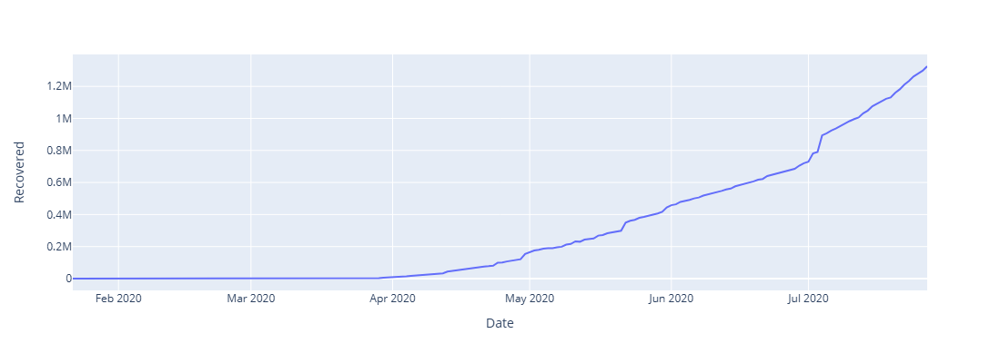

In [120]:
px.line(df_US, x='Date', y='Recovered', height=400)

In [121]:
px.line(df_US, x='Date', y='Deaths', height=400)

In [122]:
px.line(df_US, x='Date', y='Confirmed', height=400)

In [123]:
px.line(df_US, x='Date', y='New cases', height=400)

In [124]:
# Now let us create bar charts and study the USA situation using that.
px.bar(df_US, x='Date', y='New cases', height=400)

In [125]:
px.scatter(df_US, x='Confirmed', y='Deaths', height=400)

## Step 9: Visualization of Data in terms of Maps

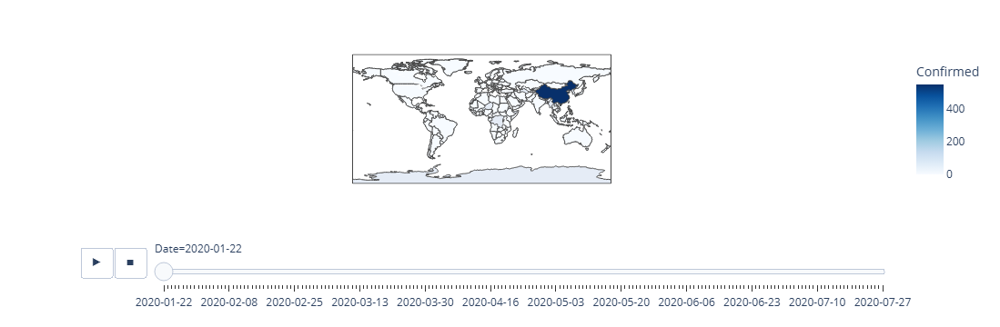

In [132]:
# Equi-rectangular Projection:
px.choropleth(
    dataset2, locations='iso_alpha',
    color='Confirmed', hover_name='Country/Region',
    color_continuous_scale='Blues', animation_frame='Date'
)

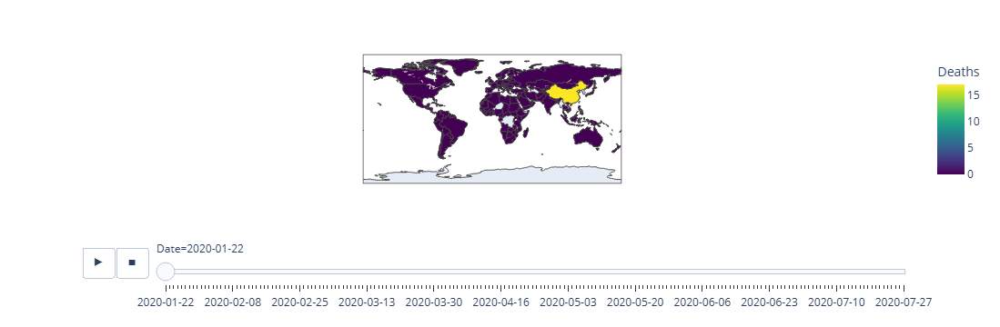

In [134]:
px.choropleth(
    dataset2, locations='iso_alpha', color='Deaths', hover_name='Country/Region',
    color_continuous_scale='Viridis', animation_frame='Date'
)

In [128]:
dataset2.head(2)

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region,iso_alpha
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0,Eastern Mediterranean,AFG
1,2020-01-22,Albania,0,0,0,0,0,0,0,Europe,ALB


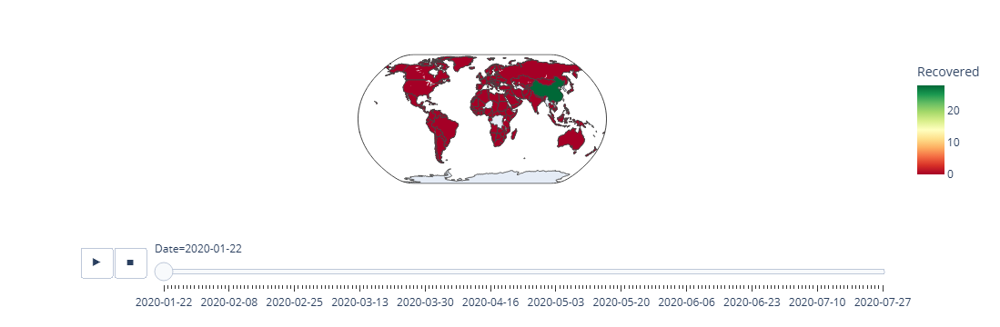

In [136]:
# Natural earth projection
px.choropleth(
    dataset2, locations='iso_alpha',color='Recovered', hover_name='Country/Region',
    color_continuous_scale="RdYlGn", projection='natural earth', animation_frame='Date'
)

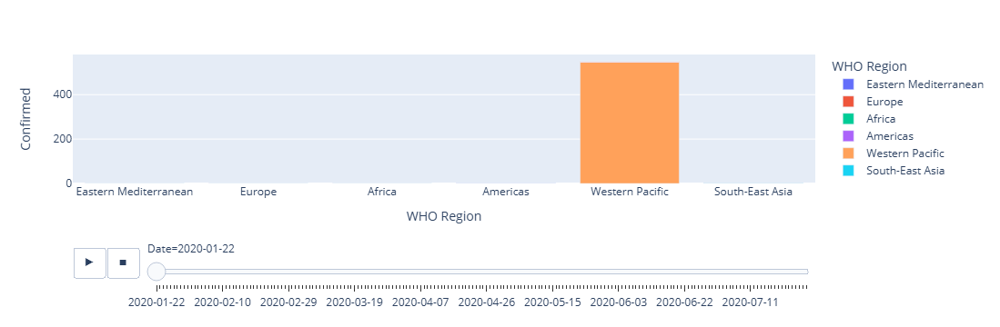

In [137]:
#Bar graph animation
px.bar(
    dataset2, x='WHO Region', y='Confirmed', color='WHO Region', 
    hover_name='Country/Region', animation_frame='Date'
)

## Step 10: Visualize text using Word Cloud

In [138]:
dataset3 = pd.read_csv('coviddeath.csv')
dataset3.head()

,Data as of,Start Week,End Week,State,Condition Group,Condition,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
0,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,0-24,122.0,NaN
1,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,25-34,596.0,NaN
2,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,35-44,1521.0,NaN
3,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,45-54,4186.0,NaN
4,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,55-64,10014.0,NaN


In [139]:
dataset3.tail()

,Data as of,Start Week,End Week,State,Condition Group,Condition,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
12255,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,65-74,5024.0,NaN
12256,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,75-84,5381.0,NaN
12257,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,85+,4841.0,NaN
12258,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,Not stated,NaN,Counts less than 10 suppressed.
12259,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,All ages,20628.0,NaN


In [140]:
dataset3.groupby("Condition").count()

,Data as of,Start Week,End Week,State,Condition Group,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
Condition,,,,,,,,,
Adult respiratory distress syndrome,540,540,540,540,540,540,540,272,268
All other conditions and causes (residual),540,540,540,540,540,540,540,363,177
Alzheimer disease,530,530,530,530,530,530,530,144,386
COVID-19,540,540,540,540,540,540,540,377,163
Cardiac arrest,520,520,520,520,520,520,520,219,301
Cardiac arrhythmia,540,540,540,540,540,540,540,192,348
Cerebrovascular diseases,530,530,530,530,530,530,530,187,343
Chronic lower respiratory diseases,540,540,540,540,540,540,540,229,311
Diabetes,540,540,540,540,540,540,540,276,264


In [141]:
# Creating wordcloud
from wordcloud import WordCloud

In [142]:
sentences = dataset3['Condition'].tolist()

In [144]:
sentences_as_a_string = ' '.join(sentences)

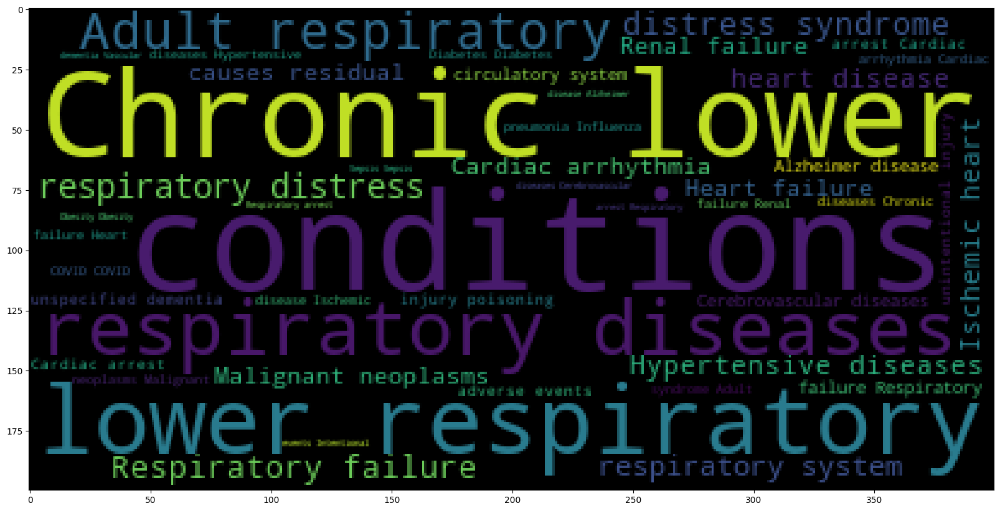

In [150]:
# Convert the string into WordCloud
plt.figure(figsize=(20, 20))
plt.imshow(WordCloud().generate(sentences_as_a_string))
plt.show()

### From the output, it can be clearly seen that the leading cause of death is Influenza Pneumonia.

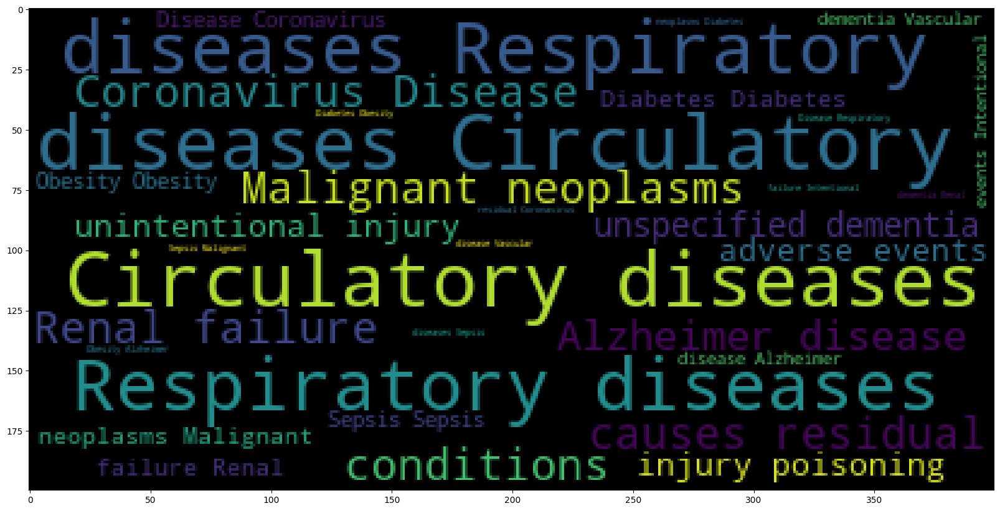

In [152]:
column_tolist = dataset3['Condition Group'].tolist()
# Convert the list to one single string
column_tostring = ' '.join(column_tolist)
# Convert the string into WordCloud
plt.figure(figsize=(20, 20))
plt.imshow(WordCloud().generate(column_tostring))
plt.show()

### Here, respiratory diseases are the major cause of death followed by circulatory diseases which are cardiovascular diseases.